In [1]:
import pandas as pd
import os
from pathlib import Path
import re

def load_trading_data() -> dict[str, pd.DataFrame]:
    """
    Load trading data from CSV files in round directories into pandas DataFrames,
    keeping only the latest round's data for each day.

    Returns:
        Dict[str, pd.DataFrame]: Dictionary containing the following DataFrames:
            - 'prices': Price data for all days (latest round only)
            - 'trades': Trade data for all days (latest round only)
            - 'observations': Observation data for all days (latest round only)
    """
    # Dictionary to track the latest round for each day and data type
    latest_data = {
        'prices': {},
        'trades': {},
        'observations': {}
    }
    
    # Regex to find round directories (format: round-X-island-data-bottle)
    round_pattern = re.compile(r'^round-(\d+)-island-data-bottle$')
    
    # Regex to match files and extract type and day
    file_pattern = re.compile(r'^(prices|trades|observations)_round_(\d+)_day_(\d+)\.csv$')
    
    # Get the current directory
    current_dir = Path('.')
    print(current_dir.absolute())
    
    # First find all round directories
    round_dirs = []
    for item in current_dir.iterdir():
        if item.is_dir():
            match = round_pattern.match(item.name)
            if match:
                round_num = int(match.group(1))
                round_dirs.append((round_num, item))
    
    # Sort by round number to process in order
    round_dirs.sort()
    
    # Process each round directory
    for round_num, round_dir in round_dirs:
        for file in round_dir.iterdir():
            if file.is_file():
                match = file_pattern.match(file.name)
                if match:
                    data_type, _, day = match.groups()
                    day = int(day)
                    
                    # If we haven't seen this day yet, or if this round is newer
                    if day not in latest_data[data_type] or round_num > latest_data[data_type][day]['round']:
                        sep = ';' if data_type in ['prices', 'trades'] else ','
                        df = pd.read_csv(file, sep=sep)
                        df['day'] = day
                        df['round'] = round_num
                        if 'timestamp' in df.columns:
                            df = df.sort_values('timestamp')
                        
                        latest_data[data_type][day] = {
                            'round': round_num,
                            'data': df
                        }

    # Combine data for each type
    result = {}
    for key, day_data in latest_data.items():
        if day_data:  # Only add if we found any data
            dfs = [info['data'] for info in day_data.values()]
            result[key] = pd.concat(dfs, ignore_index=True)
            if 'timestamp' in result[key].columns:
                result[key].sort_values(['day', 'timestamp'], inplace=True)

    return result

def convert_timestamp(df: pd.DataFrame) -> pd.DataFrame:
    return df.assign(t=(df['day']) * 1_000_000 + df['timestamp']).drop(columns=['day', 'timestamp'])

In [2]:
trading_data = load_trading_data()
prices = convert_timestamp(trading_data['prices']).drop(columns='round')

/Users/cartertran/Development/imc-prosperity-3


In [3]:
prices

,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,t
0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100.0,19.0,NaN,NaN,NaN,NaN,99.5,0.0,0
1,VOLCANIC_ROCK,10502.0,205.0,NaN,NaN,NaN,NaN,10504.0,146.0,10505.0,59.0,NaN,NaN,10503.0,0.0,0
2,SQUID_INK,1968.0,30.0,NaN,NaN,NaN,NaN,1971.0,30.0,NaN,NaN,NaN,NaN,1969.5,0.0,0
3,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274.0,19.0,NaN,NaN,NaN,NaN,273.5,0.0,0
4,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004.0,19.0,NaN,NaN,NaN,NaN,1003.5,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
739995,PICNIC_BASKET1,58434.0,1.0,58433.0,10.0,58432.0,30.0,58443.0,1.0,58444.0,10.0,58445.0,30.0,58438.5,0.0,4999900
739996,VOLCANIC_ROCK_VOUCHER_9750,356.0,11.0,NaN,NaN,NaN,NaN,357.0,11.0,NaN,NaN,NaN,NaN,356.5,0.0,4999900
739997,RAINFOREST_RESIN,9992.0,35.0,NaN,NaN,NaN,NaN,9999.0,1.0,10008.0,35.0,NaN,NaN,9995.5,0.0,4999900
739998,VOLCANIC_ROCK_VOUCHER_10000,122.0,11.0,NaN,NaN,NaN,NaN,123.0,11.0,NaN,NaN,NaN,NaN,122.5,0.0,4999900


In [4]:
prices = prices[prices['t'] <= 4_000_000]

In [5]:
import plotly.graph_objects as go

# 1. Extract mid prices for relevant products
products = ['PICNIC_BASKET1', 'PICNIC_BASKET2', 'CROISSANTS', 'JAMS', 'DJEMBES']
mid_prices = prices[prices['product'].isin(products)][['product', 't', 'mid_price']]

# 2. Pivot to have products as columns, indexed by t
pivoted = mid_prices.pivot(index='t', columns='product', values='mid_price')

# 3. Compute synthetic prices
pivoted['PB1_synth'] = (
    6 * pivoted['CROISSANTS'] +
    3 * pivoted['JAMS'] +
    1 * pivoted['DJEMBES']
)
pivoted['PB2_synth'] = (
    4 * pivoted['CROISSANTS'] +
    2 * pivoted['JAMS']
)

# 4. Calculate spreads
pivoted['PB1_spread'] = pivoted['PICNIC_BASKET1'] - pivoted['PB1_synth']
pivoted['PB2_spread'] = pivoted['PICNIC_BASKET2'] - pivoted['PB2_synth']

# 5. Plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=pivoted.index, y=pivoted['PB1_spread'],
    mode='lines', name='PICNIC_BASKET1 Spread'
))
fig.add_trace(go.Scatter(
    x=pivoted.index, y=pivoted['PB2_spread'],
    mode='lines', name='PICNIC_BASKET2 Spread'
))
fig.update_layout(
    title='Spread of PICNIC_BASKET1 and PICNIC_BASKET2 vs. Synthetic Price',
    xaxis_title='t',
    yaxis_title='Spread (Basket Mid Price - Synthetic Price)',
    legend_title='Product'
)
fig.show()

In [6]:
import plotly.graph_objects as go

# Extract relevant mid prices
products = ['PICNIC_BASKET2', 'CROISSANTS', 'JAMS']
mid_prices = prices[prices['product'].isin(products)][['product', 't', 'mid_price']]

# Pivot to have products as columns, indexed by t
pivoted = mid_prices.pivot(index='t', columns='product', values='mid_price')

# Compute synthetic price for PB2
pivoted['PB2_synth'] = 4 * pivoted['CROISSANTS'] + 2 * pivoted['JAMS']

# Calculate spread
pivoted['PB2_spread'] = pivoted['PICNIC_BASKET2'] - pivoted['PB2_synth']

# Drop rows with missing data for a clean plot
pivoted_clean = pivoted.dropna(subset=['PICNIC_BASKET2', 'PB2_synth', 'PB2_spread'])

# Plot
fig = go.Figure()

# Plot actual and synthetic prices
fig.add_trace(go.Scatter(
    x=pivoted_clean.index, y=pivoted_clean['PICNIC_BASKET2'],
    mode='lines', name='PICNIC_BASKET2 Mid Price'
))
fig.add_trace(go.Scatter(
    x=pivoted_clean.index, y=pivoted_clean['PB2_synth'],
    mode='lines', name='Synthetic Price (4 CROISSANTS + 2 JAMS)'
))

# Plot spread on secondary y-axis
fig.add_trace(go.Scatter(
    x=pivoted_clean.index, y=pivoted_clean['PB2_spread'],
    mode='lines', name='Spread', yaxis='y2'
))

# Update layout for dual y-axes
fig.update_layout(
    title='PICNIC_BASKET2 vs. Synthetic Price and Spread',
    xaxis_title='t',
    yaxis=dict(
        title='Price',
        side='left'
    ),
    yaxis2=dict(
        title='Spread',
        overlaying='y',
        side='right'
    ),
    legend_title='Legend'
)

fig.show()

In [7]:
import plotly.graph_objects as go

# Extract relevant mid prices
products = ['PICNIC_BASKET2', 'CROISSANTS', 'JAMS']
mid_prices = prices[prices['product'].isin(products)][['product', 't', 'mid_price']]

# Pivot to have products as columns, indexed by t
pivoted = mid_prices.pivot(index='t', columns='product', values='mid_price')

# Compute synthetic price for PB2
pivoted['PB2_synth'] = 4 * pivoted['CROISSANTS'] + 2 * pivoted['JAMS']

# Calculate spread
pivoted['PB2_spread'] = pivoted['PICNIC_BASKET2'] - pivoted['PB2_synth']

# Drop rows with missing data for a clean plot
pivoted_clean = pivoted.dropna(subset=['PB2_spread', 'CROISSANTS', 'JAMS'])

fig = go.Figure()

# CROISSANTS on y1 (left)
fig.add_trace(go.Scatter(
    x=pivoted_clean.index, y=pivoted_clean['CROISSANTS'],
    mode='lines', name='CROISSANTS Mid Price',
    line=dict(width=2, color='royalblue'),
    yaxis='y1'
))

# JAMS on y2 (right)
fig.add_trace(go.Scatter(
    x=pivoted_clean.index, y=pivoted_clean['JAMS'],
    mode='lines', name='JAMS Mid Price',
    line=dict(width=2, color='orange', dash='dot'),
    yaxis='y2'
))

# Spread on y3 (far right)
fig.add_trace(go.Scatter(
    x=pivoted_clean.index, y=pivoted_clean['PB2_spread'],
    mode='lines', name='Spread (PB2 - Synthetic)',
    line=dict(width=2, color='black', dash='dash'),
    yaxis='y3'
))

fig.update_layout(
    title='PICNIC_BASKET2 Spread vs. CROISSANTS and JAMS (Separate Y Axes)',
    xaxis=dict(
        title='Synthetic Timestamp (t)',
        tickformat=',d'
    ),
    yaxis=dict(
        title='CROISSANTS Mid Price',
        title_font=dict(color='royalblue'),
        tickfont=dict(color='royalblue'),
        side='left'
    ),
    yaxis2=dict(
        title='JAMS Mid Price',
        title_font=dict(color='orange'),
        tickfont=dict(color='orange'),
        overlaying='y',
        side='right',
        anchor='x',
        position=0.85  # slightly inset from the far right
    ),
    yaxis3=dict(
        title='Spread (PB2 - Synthetic)',
        title_font=dict(color='black'),
        tickfont=dict(color='black'),
        overlaying='y',
        side='right',
        anchor='free',
        position=0.99  # at the far right
    ),
    legend_title='Legend',
    margin=dict(l=80, r=100, t=50, b=50)
)

fig.show()

In [8]:
import pandas as pd
from sklearn.linear_model import LinearRegression

# Extract relevant mid prices
products = ['PICNIC_BASKET2', 'CROISSANTS', 'JAMS']
mid_prices = prices[prices['product'].isin(products)][['product', 't', 'mid_price']]

# Pivot to have products as columns, indexed by t
pivoted = mid_prices.pivot(index='t', columns='product', values='mid_price')

# Drop rows with missing data
pivoted_clean = pivoted.dropna(subset=['PICNIC_BASKET2', 'CROISSANTS', 'JAMS'])

In [9]:
from sklearn.linear_model import Ridge

# Features and target
X = pivoted_clean[['CROISSANTS', 'JAMS']]
y = pivoted_clean['PICNIC_BASKET2']

# Fit the model with Ridge Regression
alpha_value = 0.1  # You can adjust this value to control regularization strength
model = Ridge(alpha=alpha_value)
model.fit(X, y)

# Coefficients and intercept
print("Intercept:", model.intercept_)
print("CROISSANTS coefficient:", model.coef_[0])
print("JAMS coefficient:", model.coef_[1])
print("R^2 score:", model.score(X, y))

Intercept: 6073.871219575416
CROISSANTS coefficient: 3.0994310556584286
JAMS coefficient: 1.6654453617365617
R^2 score: 0.8804205182801067


In [10]:
print(f"PB2 ≈ {model.intercept_:.2f} + {model.coef_[0]:.2f} * CROISSANTS + {model.coef_[1]:.2f} * JAMS")

PB2 ≈ 6073.87 + 3.10 * CROISSANTS + 1.67 * JAMS


In [11]:
import plotly.graph_objects as go

# Predict PB2 prices
pivoted_clean['PB2_pred'] = model.predict(X)

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=pivoted_clean.index, y=pivoted_clean['PICNIC_BASKET2'],
    mode='lines', name='Actual PB2'
))
fig.add_trace(go.Scatter(
    x=pivoted_clean.index, y=pivoted_clean['PB2_pred'],
    mode='lines', name='Predicted PB2', line=dict(dash='dash')
))
fig.update_layout(
    title='Actual vs. Predicted PB2 Price',
    xaxis_title='Synthetic Timestamp (t)',
    yaxis_title='PB2 Mid Price'
)
fig.show()

In [12]:
# Calculate residuals
pivoted_clean['residuals'] = pivoted_clean['PICNIC_BASKET2'] - pivoted_clean['PB2_pred']

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=pivoted_clean['PB2_pred'],
    y=pivoted_clean['residuals'],
    mode='markers',
    marker=dict(size=3, color='firebrick'),
    name='Residuals'
))

fig.add_hline(y=0, line_dash='dash', line_color='black')

fig.update_layout(
    title='Residual Plot: PB2 Actual vs. Predicted',
    xaxis_title='Predicted PB2 Price',
    yaxis_title='Residuals (Actual - Predicted)',
    showlegend=False
)

fig.show()

In [13]:
import pandas as pd
from sklearn.linear_model import LinearRegression

# Extract relevant mid prices
products = ['PICNIC_BASKET1', 'CROISSANTS', 'JAMS', 'DJEMBES']
mid_prices = prices[prices['product'].isin(products)][['product', 't', 'mid_price']]

# Pivot to have products as columns, indexed by t
pivoted_pb1 = mid_prices.pivot(index='t', columns='product', values='mid_price')

# Drop rows with missing data
pivoted_pb1_clean = pivoted_pb1.dropna(subset=['PICNIC_BASKET1', 'CROISSANTS', 'JAMS', 'DJEMBES'])

In [14]:
from sklearn.linear_model import Ridge

# Features and target
X_pb1 = pivoted_pb1_clean[['CROISSANTS', 'JAMS', 'DJEMBES']]
y_pb1 = pivoted_pb1_clean['PICNIC_BASKET1']

# Fit the original Linear Regression model to get baseline coefficients
original_model = LinearRegression()
original_model.fit(X_pb1, y_pb1)
original_coefs = original_model.coef_

# Fit the Ridge Regression model with a small alpha
alpha_value = 0.1  # Small alpha for less regularization
model_pb1 = Ridge(alpha=alpha_value)
model_pb1.fit(X_pb1, y_pb1)

# Coefficients and intercept
print("Original Coefficients:", original_coefs)
print("Ridge Intercept:", model_pb1.intercept_)
print("Ridge Coefficients:", model_pb1.coef_)
print("R^2 score:", model_pb1.score(X_pb1, y_pb1))

Original Coefficients: [4.89275755 2.97067591 1.66146008]
Ridge Intercept: -3908.120528741194
Ridge Coefficients: [4.89275751 2.97067591 1.6614601 ]
R^2 score: 0.9118606215812767


In [15]:
print(f"PB1 ≈ {model_pb1.intercept_:.2f} + {model_pb1.coef_[0]:.2f} * CROISSANTS + {model_pb1.coef_[1]:.2f} * JAMS + {model_pb1.coef_[2]:.2f} * DJEMBES")

PB1 ≈ -3908.12 + 4.89 * CROISSANTS + 2.97 * JAMS + 1.66 * DJEMBES


In [16]:
import plotly.graph_objects as go

# Predict PB1 prices
pivoted_pb1_clean['PB1_pred'] = model_pb1.predict(X_pb1)

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=pivoted_pb1_clean.index, y=pivoted_pb1_clean['PICNIC_BASKET1'],
    mode='lines', name='Actual PB1'
))
fig.add_trace(go.Scatter(
    x=pivoted_pb1_clean.index, y=pivoted_pb1_clean['PB1_pred'],
    mode='lines', name='Predicted PB1', line=dict(dash='dash')
))
fig.update_layout(
    title='Actual vs. Predicted PB1 Price',
    xaxis_title='Synthetic Timestamp (t)',
    yaxis_title='PB1 Mid Price'
)
fig.show()

In [17]:
# Calculate residuals
pivoted_pb1_clean['residuals'] = pivoted_pb1_clean['PICNIC_BASKET1'] - pivoted_pb1_clean['PB1_pred']

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=pivoted_pb1_clean['PB1_pred'],
    y=pivoted_pb1_clean['residuals'],
    mode='markers',
    marker=dict(size=3, color='firebrick'),
    name='Residuals'
))
fig.add_hline(y=0, line_dash='dash', line_color='black')
fig.update_layout(
    title='Residual Plot: PB1 Actual vs. Predicted',
    xaxis_title='Predicted PB1 Price',
    yaxis_title='Residuals (Actual - Predicted)',
    showlegend=False
)
fig.show()

In [18]:
# Calculate residuals
pivoted_pb1_clean['residuals'] = pivoted_pb1_clean['PICNIC_BASKET1'] - pivoted_pb1_clean['PB1_pred']

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=pivoted_pb1_clean.index,  # Use the 't' column for the x-axis
    y=pivoted_pb1_clean['residuals'],
    mode='markers',
    marker=dict(size=3, color='firebrick'),
    name='Residuals'
))
fig.add_hline(y=0, line_dash='dash', line_color='black')
fig.update_layout(
    title='Residual Plot: PB1 Residuals over Time',
    xaxis_title='Time',
    yaxis_title='Residuals (Actual - Predicted)',
    showlegend=False
)
fig.show()

In [19]:
import pandas as pd
from sklearn.linear_model import Ridge

# Assuming 'pivoted_pb1_clean' is your DataFrame with mid prices and 'PICNIC_BASKET1' column

# Define the products
products = ['CROISSANTS', 'JAMS', 'DJEMBES']

# Define lags
lags = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

# Add lagged features
for product in products:
    for lag in lags:
        pivoted_pb1_clean[f'{product}_lag{lag}'] = pivoted_pb1_clean[product].shift(lag)

# Drop rows with NaN values after adding lagged features
pivoted_pb1_clean = pivoted_pb1_clean.dropna()

# Prepare features and target
X = pivoted_pb1_clean[[f'{product}_lag1' for product in products]]
y = pivoted_pb1_clean['PICNIC_BASKET1']  # Set the target to PICNIC_BASKET1

# Split the data into training and testing sets
split_idx = int(len(X) * 0.8)
X_train, X_test, y_train, y_test = X[:split_idx], X[split_idx:], y[:split_idx], y[split_idx:]

# Fit a Ridge regression model
ridge_model = Ridge(alpha=0.1)
ridge_model.fit(X_train, y_train)

# Optionally, evaluate the model
train_score = ridge_model.score(X_train, y_train)
test_score = ridge_model.score(X_test, y_test)

print(f'Training Score: {train_score}')
print(f'Test Score: {test_score}')

Training Score: 0.9385527495458351
Test Score: -5.169082797365782


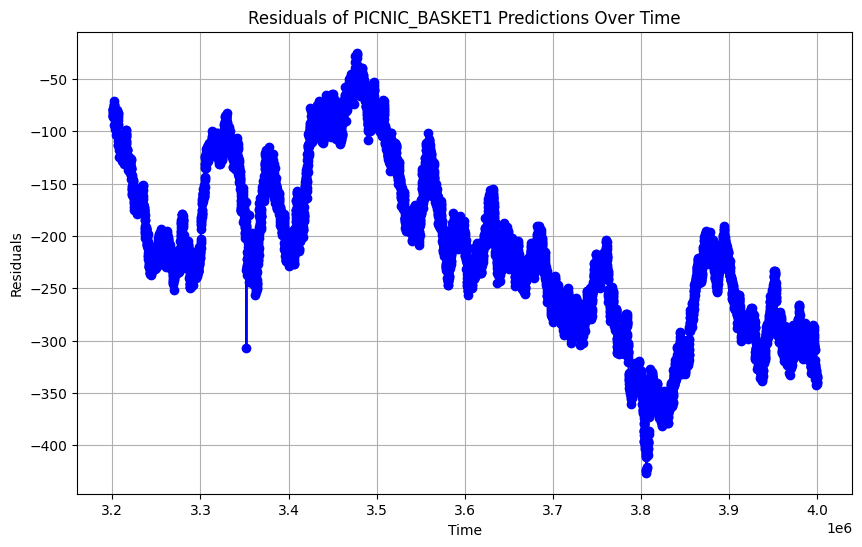

In [20]:
import matplotlib.pyplot as plt

# Predict the PICNIC_BASKET1 prices for the test set
y_pred = ridge_model.predict(X_test)

# Calculate residuals
residuals = y_test - y_pred

# Plot residuals over time
plt.figure(figsize=(10, 6))
plt.plot(pivoted_pb1_clean.index[split_idx:], residuals, marker='o', linestyle='-', color='b')
plt.title('Residuals of PICNIC_BASKET1 Predictions Over Time')
plt.xlabel('Time')
plt.ylabel('Residuals')
plt.grid(True)
plt.show()

In [21]:
import pandas as pd
from sklearn.linear_model import Ridge

# Assuming 'pivoted_pb1_clean' is your DataFrame with mid prices and 'PICNIC_BASKET1' column

# Define the products
products = ['CROISSANTS', 'JAMS']

# Define lags
lags = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

# Add lagged features
for product in products:
    for lag in lags:
        pivoted_clean[f'{product}_lag{lag}'] = pivoted_clean[product].shift(lag)

# Drop rows with NaN values after adding lagged features
pivoted_clean = pivoted_clean.dropna()

# Prepare features and target
X = pivoted_clean[[f'{product}_lag1' for product in products]]
y = pivoted_clean['PICNIC_BASKET2']  # Set the target to PICNIC_BASKET2

# Split the data into training and testing sets
split_idx = int(len(X) * 0.8)
X_train, X_test, y_train, y_test = X[:split_idx], X[split_idx:], y[:split_idx], y[split_idx:]

# Fit a Ridge regression model
ridge_model = Ridge(alpha=0.1)
ridge_model.fit(X_train, y_train)

# Optionally, evaluate the model
train_score = ridge_model.score(X_train, y_train)
test_score = ridge_model.score(X_test, y_test)

print(f'Training Score: {train_score}')
print(f'Test Score: {test_score}')

Training Score: 0.9053364414834779
Test Score: -0.41677663042761415


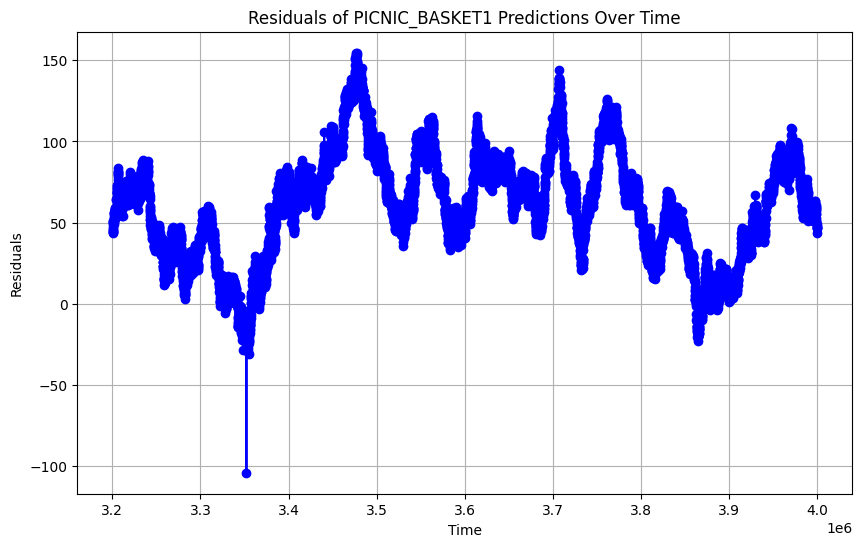

In [22]:
import matplotlib.pyplot as plt

# Predict the PICNIC_BASKET1 prices for the test set
y_pred = ridge_model.predict(X_test)

# Calculate residuals
residuals = y_test - y_pred

# Plot residuals over time
plt.figure(figsize=(10, 6))
plt.plot(pivoted_clean.index[split_idx:], residuals, marker='o', linestyle='-', color='b')
plt.title('Residuals of PICNIC_BASKET1 Predictions Over Time')
plt.xlabel('Time')
plt.ylabel('Residuals')
plt.grid(True)
plt.show()

# maybe we just find the historical mean...

In [23]:
pivoted_pb1_clean

product,CROISSANTS,DJEMBES,JAMS,PICNIC_BASKET1,PB1_pred,residuals,CROISSANTS_lag1,CROISSANTS_lag2,CROISSANTS_lag3,CROISSANTS_lag4,...,DJEMBES_lag1,DJEMBES_lag2,DJEMBES_lag3,DJEMBES_lag4,DJEMBES_lag5,DJEMBES_lag6,DJEMBES_lag7,DJEMBES_lag8,DJEMBES_lag9,DJEMBES_lag10
t,,,,,,,,,,,,,,,,,,,,,
1000,4321.5,13493.5,6631.5,59238.5,59354.880122,-116.380122,4321.5,4322.0,4321.5,4322.0,...,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.0,13493.5
1100,4321.5,13493.5,6631.5,59237.5,59354.880122,-117.380122,4321.5,4321.5,4322.0,4321.5,...,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.0
1200,4321.5,13493.5,6631.5,59236.5,59354.880122,-118.380122,4321.5,4321.5,4321.5,4322.0,...,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5
1300,4321.5,13493.5,6631.5,59231.5,59354.880122,-123.380122,4321.5,4321.5,4321.5,4321.5,...,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5
1400,4321.5,13493.5,6631.5,59234.5,59354.880122,-120.380122,4321.5,4321.5,4321.5,4321.5,...,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5,13493.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3999600,4294.5,13372.0,6446.5,58326.0,58471.333225,-145.333225,4294.5,4294.5,4294.5,4294.5,...,13371.5,13371.5,13372.0,13372.0,13371.5,13372.5,13373.5,13373.0,13372.5,13372.5
3999700,4295.5,13371.5,6446.0,58322.5,58473.909915,-151.409915,4294.5,4294.5,4294.5,4294.5,...,13372.0,13371.5,13371.5,13372.0,13372.0,13371.5,13372.5,13373.5,13373.0,13372.5
3999800,4295.5,13371.5,6446.0,58326.5,58473.909915,-147.409915,4295.5,4294.5,4294.5,4294.5,...,13371.5,13372.0,13371.5,13371.5,13372.0,13372.0,13371.5,13372.5,13373.5,13373.0


In [24]:
pivoted_clean

product,CROISSANTS,JAMS,PICNIC_BASKET2,PB2_pred,residuals,CROISSANTS_lag1,CROISSANTS_lag2,CROISSANTS_lag3,CROISSANTS_lag4,CROISSANTS_lag5,...,JAMS_lag1,JAMS_lag2,JAMS_lag3,JAMS_lag4,JAMS_lag5,JAMS_lag6,JAMS_lag7,JAMS_lag8,JAMS_lag9,JAMS_lag10
t,,,,,,,,,,,,,,,,,,,,,
1000,4321.5,6631.5,30506.0,30512.463443,-6.463443,4321.5,4322.0,4321.5,4322.0,4321.5,...,6632.0,6632.0,6632.0,6632.5,6632.0,6632.0,6632.0,6632.0,6631.5,6632.0
1100,4321.5,6631.5,30506.5,30512.463443,-5.963443,4321.5,4321.5,4322.0,4321.5,4322.0,...,6631.5,6632.0,6632.0,6632.0,6632.5,6632.0,6632.0,6632.0,6632.0,6631.5
1200,4321.5,6631.5,30509.0,30512.463443,-3.463443,4321.5,4321.5,4321.5,4322.0,4321.5,...,6631.5,6631.5,6632.0,6632.0,6632.0,6632.5,6632.0,6632.0,6632.0,6632.0
1300,4321.5,6631.5,30506.5,30512.463443,-5.963443,4321.5,4321.5,4321.5,4321.5,4322.0,...,6631.5,6631.5,6631.5,6632.0,6632.0,6632.0,6632.5,6632.0,6632.0,6632.0
1400,4321.5,6631.5,30506.0,30512.463443,-6.463443,4321.5,4321.5,4321.5,4321.5,4321.5,...,6631.5,6631.5,6631.5,6631.5,6632.0,6632.0,6632.0,6632.5,6632.0,6632.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3999600,4294.5,6446.5,30127.0,30120.671413,6.328587,4294.5,4294.5,4294.5,4294.5,4294.5,...,6446.5,6446.0,6446.5,6446.0,6446.0,6446.0,6446.5,6446.5,6446.0,6445.5
3999700,4295.5,6446.0,30126.0,30122.938121,3.061879,4294.5,4294.5,4294.5,4294.5,4294.5,...,6446.5,6446.5,6446.0,6446.5,6446.0,6446.0,6446.0,6446.5,6446.5,6446.0
3999800,4295.5,6446.0,30124.5,30122.938121,1.561879,4295.5,4294.5,4294.5,4294.5,4294.5,...,6446.0,6446.5,6446.5,6446.0,6446.5,6446.0,6446.0,6446.0,6446.5,6446.5


In [25]:
def calc_avg_spread(pivoted_clean):
    basket = 'PICNIC_BASKET1' if 'PICNIC_BASKET1' in pivoted_clean.columns else 'PICNIC_BASKET2'
    if basket == 'PICNIC_BASKET1':
        spreads = pivoted_clean[basket] - 6 * pivoted_clean['CROISSANTS'] - 3 * pivoted_clean['JAMS'] - 1 * pivoted_clean['DJEMBES']
    else:
        spreads = pivoted_clean[basket] - 4 * pivoted_clean['CROISSANTS'] - 2 * pivoted_clean['JAMS']
    return spreads.mean()

In [26]:
calc_avg_spread(pivoted_pb1_clean)

np.float64(19.096509214573278)

In [27]:
calc_avg_spread(pivoted_clean)

np.float64(41.74040409092046)

In [32]:
import pandas as pd
import numpy as np
from pykalman import KalmanFilter

# Starting with your existing code
# Extract relevant mid prices
products = ['PICNIC_BASKET2', 'CROISSANTS', 'JAMS']
mid_prices = prices[prices['product'].isin(products)][['product', 't', 'mid_price']]

# Pivot to have products as columns, indexed by t
pivoted = mid_prices.pivot(index='t', columns='product', values='mid_price')

# Drop rows with missing data
pivoted_clean = pivoted.dropna(subset=['PICNIC_BASKET2', 'CROISSANTS', 'JAMS'])

# Prepare data for Kalman Filter
X = pivoted_clean[['CROISSANTS', 'JAMS']].values
y = pivoted_clean['PICNIC_BASKET2'].values

# Define dimensions
n_obs = X.shape[0]  # Number of observations
n_state = 3  # [intercept, coef1, coef2]

# Initial state mean - start with zeros for [intercept, coef1, coef2]
initial_state_mean = np.zeros(n_state)

# Initial state covariance - higher values mean less certainty about initial state
initial_state_covariance = np.eye(n_state) * 10.0

# Transition matrix - identity means coefficients evolve as random walk
transition_matrices = np.eye(n_state)

# Transition covariance - controls how much coefficients can change between steps
transition_covariance = np.eye(n_state) * 0.01

# Create observation matrices - this needs to have shape (n_obs, n_dim_obs, n_dim_state)
# For linear regression, each observation matrix is [1, x1, x2]
observation_matrices = np.zeros((n_obs, 1, n_state))
for i in range(n_obs):
    observation_matrices[i] = np.array([[1, X[i, 0], X[i, 1]]])

# Observation covariance - represents noise in the observations
observation_covariance = np.array([[1.0]])

# Initialize the Kalman Filter
kf = KalmanFilter(
    initial_state_mean=initial_state_mean,
    initial_state_covariance=initial_state_covariance,
    transition_matrices=transition_matrices,
    transition_covariance=transition_covariance,
    observation_matrices=observation_matrices,
    observation_covariance=observation_covariance
)

# Run the Kalman Filter to get state means and covariances
state_means, state_covariances = kf.filter(y.reshape(-1, 1))

# The final state mean contains our estimated coefficients [intercept, coef1, coef2]
final_intercept, final_coef1, final_coef2 = state_means[-1]

# Create a function to predict PICNIC_BASKET2 based on CROISSANTS and JAMS
def predict_picnic_basket2(croissants_price, jams_price):
    return final_intercept + final_coef1 * croissants_price + final_coef2 * jams_price

# Create a DataFrame with the estimated coefficients over time
coefficients_over_time = pd.DataFrame(
    state_means, 
    index=pivoted_clean.index,
    columns=['Intercept', 'CROISSANTS_coef', 'JAMS_coef']
)

# Calculate predicted values using final coefficients
pivoted_clean['PICNIC_BASKET2_predicted'] = predict_picnic_basket2(
    pivoted_clean['CROISSANTS'], 
    pivoted_clean['JAMS']
)

# Calculate prediction error
pivoted_clean['prediction_error'] = pivoted_clean['PICNIC_BASKET2'] - pivoted_clean['PICNIC_BASKET2_predicted']

# Calculate the root mean squared error (RMSE)
rmse = np.sqrt(np.mean(pivoted_clean['prediction_error']**2))

print(f"Final coefficients: Intercept={final_intercept:.4f}, CROISSANTS={final_coef1:.4f}, JAMS={final_coef2:.4f}")
print(f"RMSE: {rmse:.4f}")

# For online prediction, you can update the model with new data
def update_prediction(state_mean, state_covariance, croissants_price, jams_price, actual_basket_price=None):
    # Create observation matrix for this new point
    new_obs_matrix = np.array([[1, croissants_price, jams_price]])
    
    # Make prediction using current state
    predicted_price = new_obs_matrix.dot(state_mean)[0]
    
    # If we have the actual price, update the state
    if actual_basket_price is not None:
        # Update step
        state_mean, state_covariance = kf.filter_update(
            filtered_state_mean=state_mean,
            filtered_state_covariance=state_covariance,
            observation=np.array([actual_basket_price]),
            observation_matrix=new_obs_matrix
        )
    
    return predicted_price, state_mean, state_covariance

# Example of using the online update function with new data
current_state_mean = state_means[-1]
current_state_covariance = state_covariances[-1]

# Get the last known prices
last_croissants = pivoted_clean['CROISSANTS'].iloc[-1]
last_jams = pivoted_clean['JAMS'].iloc[-1]

# Make a prediction for a new time step
new_prediction, updated_state_mean, updated_state_covariance = update_prediction(
    current_state_mean,
    current_state_covariance,
    last_croissants,
    last_jams
)

print(f"Predicted PICNIC_BASKET2 price: {new_prediction:.4f}")

Final coefficients: Intercept=0.0011, CROISSANTS=3.3429, JAMS=2.4461
RMSE: 92.2446
Predicted PICNIC_BASKET2 price: 30131.5000


In [33]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd
import numpy as np
from pykalman import KalmanFilter

# Starting with the existing code through the model fitting
products = ['PICNIC_BASKET2', 'CROISSANTS', 'JAMS']
mid_prices = prices[prices['product'].isin(products)][['product', 't', 'mid_price']]

# Pivot to have products as columns, indexed by t
pivoted = mid_prices.pivot(index='t', columns='product', values='mid_price')

# Drop rows with missing data
pivoted_clean = pivoted.dropna(subset=['PICNIC_BASKET2', 'CROISSANTS', 'JAMS'])

# Prepare data for Kalman Filter
X = pivoted_clean[['CROISSANTS', 'JAMS']].values
y = pivoted_clean['PICNIC_BASKET2'].values

# Define dimensions
n_obs = X.shape[0]  # Number of observations
n_state = 3  # [intercept, coef1, coef2]

# Initial state mean - start with zeros for [intercept, coef1, coef2]
initial_state_mean = np.zeros(n_state)

# Initial state covariance - higher values mean less certainty about initial state
initial_state_covariance = np.eye(n_state) * 10.0

# Transition matrix - identity means coefficients evolve as random walk
transition_matrices = np.eye(n_state)

# Transition covariance - controls how much coefficients can change between steps
transition_covariance = np.eye(n_state) * 0.01

# Create observation matrices - this needs to have shape (n_obs, n_dim_obs, n_dim_state)
# For linear regression, each observation matrix is [1, x1, x2]
observation_matrices = np.zeros((n_obs, 1, n_state))
for i in range(n_obs):
    observation_matrices[i] = np.array([[1, X[i, 0], X[i, 1]]])

# Observation covariance - represents noise in the observations
observation_covariance = np.array([[1.0]])

# Initialize the Kalman Filter
kf = KalmanFilter(
    initial_state_mean=initial_state_mean,
    initial_state_covariance=initial_state_covariance,
    transition_matrices=transition_matrices,
    transition_covariance=transition_covariance,
    observation_matrices=observation_matrices,
    observation_covariance=observation_covariance
)

# Run the Kalman Filter to get state means and covariances
state_means, state_covariances = kf.filter(y.reshape(-1, 1))

# The final state mean contains our estimated coefficients [intercept, coef1, coef2]
final_intercept, final_coef1, final_coef2 = state_means[-1]

# Calculate predicted values for all time steps using the time-varying coefficients
predictions = []
for i in range(n_obs):
    intercept, coef1, coef2 = state_means[i]
    pred = intercept + coef1 * X[i, 0] + coef2 * X[i, 1]
    predictions.append(pred)

# Calculate residuals
residuals = y - predictions

# Create a DataFrame with time index, actual, predicted, and residuals
results_df = pd.DataFrame({
    'timestamp': pivoted_clean.index,
    'actual': y,
    'predicted': predictions,
    'residual': residuals
})

# Create subplots: actual vs predicted and residuals
fig = make_subplots(
    rows=2, cols=1,
    subplot_titles=('Actual vs Predicted PICNIC_BASKET2', 'Residuals'),
    shared_xaxes=True,
    vertical_spacing=0.1
)

# Add actual vs predicted trace
fig.add_trace(
    go.Scatter(
        x=results_df['timestamp'],
        y=results_df['actual'],
        mode='lines',
        name='Actual PICNIC_BASKET2',
        line=dict(color='blue')
    ),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(
        x=results_df['timestamp'],
        y=results_df['predicted'],
        mode='lines',
        name='Kalman Filter Prediction',
        line=dict(color='red')
    ),
    row=1, col=1
)

# Add residuals trace
fig.add_trace(
    go.Scatter(
        x=results_df['timestamp'],
        y=results_df['residual'],
        mode='markers+lines',
        name='Residuals',
        marker=dict(color='green', size=4),
        line=dict(width=1, color='green')
    ),
    row=2, col=1
)

# Add a horizontal line at y=0 for residuals plot
fig.add_trace(
    go.Scatter(
        x=[results_df['timestamp'].min(), results_df['timestamp'].max()],
        y=[0, 0],
        mode='lines',
        line=dict(color='black', width=1, dash='dash'),
        showlegend=False
    ),
    row=2, col=1
)

# Update layout
fig.update_layout(
    height=800,
    title_text='Kalman Filter OLS Regression Analysis for PICNIC_BASKET2',
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    template='plotly_white'
)

# Update y-axis labels
fig.update_yaxes(title_text='Price', row=1, col=1)
fig.update_yaxes(title_text='Residual', row=2, col=1)

# Create a trace for coefficient evolution over time
coef_fig = go.Figure()

# Add traces for each coefficient
coef_fig.add_trace(
    go.Scatter(
        x=pivoted_clean.index,
        y=[mean[0] for mean in state_means],
        mode='lines',
        name='Intercept',
        line=dict(width=2)
    )
)

coef_fig.add_trace(
    go.Scatter(
        x=pivoted_clean.index,
        y=[mean[1] for mean in state_means],
        mode='lines',
        name='CROISSANTS Coefficient',
        line=dict(width=2)
    )
)

coef_fig.add_trace(
    go.Scatter(
        x=pivoted_clean.index,
        y=[mean[2] for mean in state_means],
        mode='lines',
        name='JAMS Coefficient',
        line=dict(width=2)
    )
)

# Update layout for coefficient evolution plot
coef_fig.update_layout(
    title='Evolution of Regression Coefficients Over Time',
    xaxis_title='Timestamp',
    yaxis_title='Coefficient Value',
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    template='plotly_white'
)

# Calculate RMSE
rmse = np.sqrt(np.mean(residuals**2))
print(f"RMSE: {rmse:.4f}")
print(f"Final coefficients: Intercept={final_intercept:.4f}, CROISSANTS={final_coef1:.4f}, JAMS={final_coef2:.4f}")

# Display both figures
fig.show()
coef_fig.show()

# Create a residual vs fitted plot to check for heteroscedasticity
resid_fitted_fig = go.Figure()

resid_fitted_fig.add_trace(
    go.Scatter(
        x=predictions,
        y=residuals,
        mode='markers',
        marker=dict(
            color='blue',
            size=6,
            opacity=0.7
        ),
        name='Residuals'
    )
)

# Add horizontal line at y=0
resid_fitted_fig.add_trace(
    go.Scatter(
        x=[min(predictions), max(predictions)],
        y=[0, 0],
        mode='lines',
        line=dict(color='red', width=2, dash='dash'),
        showlegend=False
    )
)

# Update layout for residual vs fitted plot
resid_fitted_fig.update_layout(
    title='Residuals vs Fitted Values',
    xaxis_title='Fitted Values',
    yaxis_title='Residuals',
    template='plotly_white'
)

resid_fitted_fig.show()

RMSE: 0.0000
Final coefficients: Intercept=0.0011, CROISSANTS=3.3429, JAMS=2.4461


In [34]:
import pandas as pd
import numpy as np
from pykalman import KalmanFilter
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.metrics import mean_squared_error, r2_score

# Starting with the existing code
products = ['PICNIC_BASKET2', 'CROISSANTS', 'JAMS']
mid_prices = prices[prices['product'].isin(products)][['product', 't', 'mid_price']]

# Pivot to have products as columns, indexed by t
pivoted = mid_prices.pivot(index='t', columns='product', values='mid_price')

# Drop rows with missing data
pivoted_clean = pivoted.dropna(subset=['PICNIC_BASKET2', 'CROISSANTS', 'JAMS'])

# Split the data into training and testing sets (80/20 split)
train_size = int(len(pivoted_clean) * 0.8)
train_data = pivoted_clean.iloc[:train_size]
test_data = pivoted_clean.iloc[train_size:]

print(f"Training set size: {len(train_data)}")
print(f"Test set size: {len(test_data)}")

# Prepare training data for Kalman Filter
X_train = train_data[['CROISSANTS', 'JAMS']].values
y_train = train_data['PICNIC_BASKET2'].values

# Define dimensions
n_obs_train = X_train.shape[0]
n_state = 3  # [intercept, coef1, coef2]

# Initial state mean - start with zeros for [intercept, coef1, coef2]
initial_state_mean = np.zeros(n_state)

# Initial state covariance - higher values mean less certainty about initial state
initial_state_covariance = np.eye(n_state) * 10.0

# Transition matrix - identity means coefficients evolve as random walk
transition_matrices = np.eye(n_state)

# Transition covariance - controls how much coefficients can change between steps
transition_covariance = np.eye(n_state) * 0.01

# Create observation matrices for training data
observation_matrices_train = np.zeros((n_obs_train, 1, n_state))
for i in range(n_obs_train):
    observation_matrices_train[i] = np.array([[1, X_train[i, 0], X_train[i, 1]]])

# Observation covariance - represents noise in the observations
observation_covariance = np.array([[1.0]])

# Initialize the Kalman Filter
kf = KalmanFilter(
    initial_state_mean=initial_state_mean,
    initial_state_covariance=initial_state_covariance,
    transition_matrices=transition_matrices,
    transition_covariance=transition_covariance,
    observation_matrices=observation_matrices_train,
    observation_covariance=observation_covariance
)

# Run the Kalman Filter on training data
state_means_train, state_covariances_train = kf.filter(y_train.reshape(-1, 1))

# The final state from training will be our starting point for testing
final_train_state_mean = state_means_train[-1]
final_train_state_covariance = state_covariances_train[-1]

# Function to make predictions for new data using the trained Kalman filter
def predict_with_kalman(X_new, final_state_mean):
    predictions = []
    for i in range(len(X_new)):
        x1, x2 = X_new[i]
        pred = final_state_mean[0] + final_state_mean[1] * x1 + final_state_mean[2] * x2
        predictions.append(pred)
    return np.array(predictions)

# Prepare test data
X_test = test_data[['CROISSANTS', 'JAMS']].values
y_test = test_data['PICNIC_BASKET2'].values

# Generate predictions on test data
y_pred_test = predict_with_kalman(X_test, final_train_state_mean)

# Calculate test set metrics
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred_test))
test_r2 = r2_score(y_test, y_pred_test)

# Calculate training set predictions and metrics
y_pred_train = predict_with_kalman(X_train, final_train_state_mean)
train_rmse = np.sqrt(mean_squared_error(y_train, y_pred_train))
train_r2 = r2_score(y_train, y_pred_train)

print(f"Training RMSE: {train_rmse:.4f}")
print(f"Training R²: {train_r2:.4f}")
print(f"Test RMSE: {test_rmse:.4f}")
print(f"Test R²: {test_r2:.4f}")
print(f"Final coefficients: Intercept={final_train_state_mean[0]:.4f}, CROISSANTS={final_train_state_mean[1]:.4f}, JAMS={final_train_state_mean[2]:.4f}")

# Create a dataframe with actual vs predicted values
test_results = pd.DataFrame({
    'timestamp': test_data.index,
    'actual': y_test,
    'predicted': y_pred_test,
    'residual': y_test - y_pred_test
})

# Create visualization for test set predictions
fig = make_subplots(
    rows=2, cols=1,
    subplot_titles=('Test Set: Actual vs Predicted PICNIC_BASKET2', 'Test Set: Residuals'),
    shared_xaxes=True,
    vertical_spacing=0.1
)

# Add actual vs predicted trace
fig.add_trace(
    go.Scatter(
        x=test_results['timestamp'],
        y=test_results['actual'],
        mode='lines',
        name='Actual PICNIC_BASKET2',
        line=dict(color='blue')
    ),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(
        x=test_results['timestamp'],
        y=test_results['predicted'],
        mode='lines',
        name='Kalman Filter Prediction',
        line=dict(color='red')
    ),
    row=1, col=1
)

# Add residuals trace
fig.add_trace(
    go.Scatter(
        x=test_results['timestamp'],
        y=test_results['residual'],
        mode='markers+lines',
        name='Residuals',
        marker=dict(color='green', size=4),
        line=dict(width=1, color='green')
    ),
    row=2, col=1
)

# Add a horizontal line at y=0 for residuals plot
fig.add_trace(
    go.Scatter(
        x=[test_results['timestamp'].min(), test_results['timestamp'].max()],
        y=[0, 0],
        mode='lines',
        line=dict(color='black', width=1, dash='dash'),
        showlegend=False
    ),
    row=2, col=1
)

# Update layout
fig.update_layout(
    height=800,
    title_text='Kalman Filter OLS Test Set Evaluation',
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    template='plotly_white',
    annotations=[
        dict(
            x=0.5,
            y=1.05,
            showarrow=False,
            text=f"Test RMSE: {test_rmse:.4f}, R²: {test_r2:.4f}",
            xref="paper",
            yref="paper",
            font=dict(size=14)
        )
    ]
)

# Update y-axis labels
fig.update_yaxes(title_text='Price', row=1, col=1)
fig.update_yaxes(title_text='Residual', row=2, col=1)

# Create a scatter plot of actual vs predicted values
scatter_fig = go.Figure()

scatter_fig.add_trace(
    go.Scatter(
        x=test_results['actual'],
        y=test_results['predicted'],
        mode='markers',
        marker=dict(color='blue', size=8, opacity=0.7),
        name='Test Data Points'
    )
)

# Add line representing perfect predictions (y=x)
max_val = max(max(test_results['actual']), max(test_results['predicted']))
min_val = min(min(test_results['actual']), min(test_results['predicted']))
scatter_fig.add_trace(
    go.Scatter(
        x=[min_val, max_val],
        y=[min_val, max_val],
        mode='lines',
        line=dict(color='red', width=2, dash='dash'),
        name='Perfect Prediction'
    )
)

scatter_fig.update_layout(
    title='Test Set: Actual vs Predicted Values',
    xaxis_title='Actual PICNIC_BASKET2 Price',
    yaxis_title='Predicted PICNIC_BASKET2 Price',
    template='plotly_white',
    annotations=[
        dict(
            x=0.05,
            y=0.95,
            showarrow=False,
            text=f"R² = {test_r2:.4f}",
            xref="paper",
            yref="paper",
            font=dict(size=14)
        )
    ]
)

# Display the figures
fig.show()
scatter_fig.show()

# Compare with an online approach where we continuously update the model
def online_predict_evaluate(X_test, y_test, initial_state_mean, initial_state_covariance):
    # Initialize results containers
    predictions = []
    updated_state_means = [initial_state_mean]
    updated_state_covs = [initial_state_covariance]
    
    current_state_mean = initial_state_mean
    current_state_covariance = initial_state_covariance
    
    # For each test point, predict then update
    for i in range(len(X_test)):
        # Create observation matrix for this point
        obs_matrix = np.array([[1, X_test[i, 0], X_test[i, 1]]])
        
        # Predict using current state
        pred = current_state_mean[0] + current_state_mean[1] * X_test[i, 0] + current_state_mean[2] * X_test[i, 1]
        predictions.append(pred)
        
        # Update the model with the actual value
        current_state_mean, current_state_covariance = kf.filter_update(
            filtered_state_mean=current_state_mean,
            filtered_state_covariance=current_state_covariance,
            observation=np.array([y_test[i]]),
            observation_matrix=obs_matrix
        )
        
        updated_state_means.append(current_state_mean)
        updated_state_covs.append(current_state_covariance)
    
    # Calculate performance metrics
    online_rmse = np.sqrt(mean_squared_error(y_test, predictions))
    online_r2 = r2_score(y_test, predictions)
    
    return predictions, updated_state_means, updated_state_covs, online_rmse, online_r2

# Run online prediction and evaluation
online_preds, online_states, online_covs, online_rmse, online_r2 = online_predict_evaluate(
    X_test, y_test, final_train_state_mean, final_train_state_covariance
)

print(f"Online prediction Test RMSE: {online_rmse:.4f}")
print(f"Online prediction Test R²: {online_r2:.4f}")

# Compare static vs online predictions
comparison_fig = go.Figure()

comparison_fig.add_trace(
    go.Scatter(
        x=test_data.index,
        y=y_test,
        mode='lines',
        name='Actual PICNIC_BASKET2',
        line=dict(color='blue')
    )
)

comparison_fig.add_trace(
    go.Scatter(
        x=test_data.index,
        y=y_pred_test,
        mode='lines',
        name='Static Prediction',
        line=dict(color='red')
    )
)

comparison_fig.add_trace(
    go.Scatter(
        x=test_data.index,
        y=online_preds,
        mode='lines',
        name='Online Prediction',
        line=dict(color='green')
    )
)

comparison_fig.update_layout(
    title='Comparison of Static vs Online Prediction Methods',
    xaxis_title='Timestamp',
    yaxis_title='PICNIC_BASKET2 Price',
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    template='plotly_white',
    annotations=[
        dict(
            x=0.5,
            y=1.05,
            showarrow=False,
            text=f"Static RMSE: {test_rmse:.4f}, Online RMSE: {online_rmse:.4f}",
            xref="paper",
            yref="paper",
            font=dict(size=14)
        )
    ]
)

comparison_fig.show()

# Plot the evolution of coefficients in the online model
coef_names = ['Intercept', 'CROISSANTS Coefficient', 'JAMS Coefficient']
colors = ['blue', 'red', 'green']

coef_fig = go.Figure()

# Add traces for all three coefficients
for i in range(3):
    coef_fig.add_trace(
        go.Scatter(
            x=list(range(len(online_states))),
            y=[state[i] for state in online_states],
            mode='lines',
            name=coef_names[i],
            line=dict(color=colors[i], width=2)
        )
    )

coef_fig.update_layout(
    title='Evolution of Coefficients During Online Prediction',
    xaxis_title='Test Sample Index',
    yaxis_title='Coefficient Value',
    template='plotly_white'
)

coef_fig.show()

Training set size: 32000
Test set size: 8001
Training RMSE: 87.5848
Training R²: 0.7090
Test RMSE: 45.0203
Test R²: 0.3918
Final coefficients: Intercept=0.0008, CROISSANTS=3.0368, JAMS=2.6432


Online prediction Test RMSE: 2.3553
Online prediction Test R²: 0.9983


In [35]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

# Calculate residuals for the online predictions
online_residuals = y_test - np.array(online_preds)

# Create a dataframe with all the information
residual_df = pd.DataFrame({
    'timestamp': test_data.index,
    'actual': y_test,
    'predicted': online_preds,
    'residual': online_residuals
})

# Create a comprehensive residual analysis plot with 3 subplots
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=(
        'Online Kalman Filter: Residuals Over Time', 
        'Online Kalman Filter: Residuals vs Predicted Values',
        'Online Kalman Filter: Residual Distribution'
    ),
    shared_xaxes=False,
    vertical_spacing=0.1,
    row_heights=[0.33, 0.33, 0.33]
)

# 1. Residuals over time
fig.add_trace(
    go.Scatter(
        x=residual_df['timestamp'],
        y=residual_df['residual'],
        mode='markers+lines',
        name='Residuals',
        marker=dict(color='blue', size=3, opacity=0.7),
        line=dict(width=1, color='blue', dash='dot')
    ),
    row=1, col=1
)

# Add horizontal line at y=0
fig.add_trace(
    go.Scatter(
        x=[residual_df['timestamp'].min(), residual_df['timestamp'].max()],
        y=[0, 0],
        mode='lines',
        line=dict(color='red', width=2, dash='dash'),
        showlegend=False
    ),
    row=1, col=1
)

# 2. Residuals vs Predicted Values
fig.add_trace(
    go.Scatter(
        x=residual_df['predicted'],
        y=residual_df['residual'],
        mode='markers',
        marker=dict(
            color='green',
            size=5,
            opacity=0.7
        ),
        name='Residuals vs Predicted'
    ),
    row=2, col=1
)

# Add horizontal line at y=0
fig.add_trace(
    go.Scatter(
        x=[min(residual_df['predicted']), max(residual_df['predicted'])],
        y=[0, 0],
        mode='lines',
        line=dict(color='red', width=2, dash='dash'),
        showlegend=False
    ),
    row=2, col=1
)

# 3. Histogram of residuals
fig.add_trace(
    go.Histogram(
        x=residual_df['residual'],
        nbinsx=50,
        marker_color='purple',
        opacity=0.7,
        name='Residual Distribution'
    ),
    row=3, col=1
)

# Calculate residual statistics
mean_residual = np.mean(online_residuals)
std_residual = np.std(online_residuals)
rmse = np.sqrt(np.mean(online_residuals**2))
max_abs_residual = np.max(np.abs(online_residuals))

# Update layout with statistics annotations
fig.update_layout(
    height=900,
    title_text='Online Kalman Filter OLS Residual Analysis',
    template='plotly_white',
    showlegend=True,
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    annotations=[
        dict(
            x=0.01,
            y=0.98,
            showarrow=False,
            text=f"RMSE: {rmse:.4f}<br>Mean Residual: {mean_residual:.4f}<br>Std Dev: {std_residual:.4f}<br>Max Absolute: {max_abs_residual:.4f}",
            xref="paper",
            yref="paper",
            align="left",
            bgcolor="rgba(255, 255, 255, 0.8)",
            bordercolor="black",
            borderwidth=1,
            font=dict(size=12)
        )
    ]
)

# Update axes labels
fig.update_yaxes(title_text='Residual', row=1, col=1)
fig.update_xaxes(title_text='Timestamp', row=1, col=1)

fig.update_yaxes(title_text='Residual', row=2, col=1)
fig.update_xaxes(title_text='Predicted PICNIC_BASKET2 Value', row=2, col=1)

fig.update_yaxes(title_text='Frequency', row=3, col=1)
fig.update_xaxes(title_text='Residual Value', row=3, col=1)

# Create a 2D residual heatmap to see if there are patterns
heatmap_fig = go.Figure(data=go.Histogram2d(
    x=residual_df['predicted'],
    y=residual_df['residual'],
    colorscale='Viridis',
    nbinsx=50,
    nbinsy=50,
    colorbar=dict(title='Count')
))

heatmap_fig.update_layout(
    title='2D Histogram of Residuals vs Predicted Values',
    xaxis_title='Predicted PICNIC_BASKET2 Value',
    yaxis_title='Residual',
    template='plotly_white'
)

# Create ACF (Autocorrelation Function) plot for residuals
from statsmodels.tsa.stattools import acf

# Calculate autocorrelation for residuals
acf_values = acf(online_residuals, nlags=50)
acf_x = np.arange(len(acf_values))

# Create ACF plot
acf_fig = go.Figure()
acf_fig.add_trace(go.Bar(
    x=acf_x,
    y=acf_values,
    marker_color='blue',
    name='ACF'
))

# Add confidence intervals (95%)
conf_level = 1.96 / np.sqrt(len(online_residuals))
acf_fig.add_trace(go.Scatter(
    x=acf_x,
    y=[conf_level] * len(acf_x),
    mode='lines',
    line=dict(dash='dash', color='red'),
    name='Upper CI'
))

acf_fig.add_trace(go.Scatter(
    x=acf_x,
    y=[-conf_level] * len(acf_x),
    mode='lines',
    line=dict(dash='dash', color='red'),
    name='Lower CI'
))

acf_fig.update_layout(
    title='Autocorrelation Function of Residuals',
    xaxis_title='Lag',
    yaxis_title='Autocorrelation',
    template='plotly_white',
    showlegend=True
)

# Show all figures
fig.show()
heatmap_fig.show()
acf_fig.show()

In [36]:
# Initial state (coefficients) for prediction
initial_state_mean = np.array([0.0008, 3.0368, 2.6432])  # [intercept, CROISSANTS, JAMS]

# State covariance (uncertainty in the coefficients)
initial_state_covariance = np.array([
    [0.01, 0, 0],
    [0, 0.01, 0],
    [0, 0, 0.01]
])  # Starting with identity * 0.01

# Transition matrix (how coefficients evolve)
transition_matrix = np.eye(3)  # Identity matrix for random walk

# Transition covariance (how much coefficients can change)
transition_covariance = np.eye(3) * 0.01

# Observation covariance (noise in the price observations)
observation_covariance = np.array([[1.0]])

# For online predictions in your trading bot
def predict_picnic_basket2(state_mean, croissants_price, jams_price):
    """Predict PICNIC_BASKET2 price based on current state and input prices"""
    return state_mean[0] + state_mean[1] * croissants_price + state_mean[2] * jams_price

def update_kalman_state(kf, state_mean, state_covariance, croissants_price, jams_price, actual_basket_price):
    """Update the Kalman filter state with a new observation"""
    # Create observation matrix for this new point
    obs_matrix = np.array([[1, croissants_price, jams_price]])
    
    # Update the state
    updated_state_mean, updated_state_covariance = kf.filter_update(
        filtered_state_mean=state_mean,
        filtered_state_covariance=state_covariance,
        observation=np.array([actual_basket_price]),
        observation_matrix=obs_matrix
    )
    
    return updated_state_mean, updated_state_covariance

# Final online model coefficients after processing all test data
final_online_coefficients = online_states[-1]  # [intercept, CROISSANTS, JAMS]
final_online_covariance = online_covs[-1]

print(f"Final Online Model Coefficients: {final_online_coefficients}")

Final Online Model Coefficients: [1.07896616e-03 3.34294941e+00 2.44605861e+00]
